#Kelompok 2 Tugas Klasifikasi Gambar

- Raffi Ardhi
- Muhammad Hanif
- Muhamad Irfan
- Fauziyyah
- Ridwan

Dalam tugas ini, kami akan mengklasifikasikan gambar yang merupakan 'mobil' dan 'bukan mobil'. Kami mengambil sumber gambar dari internet dan google maps

##Load Gambar

Pertama, yang kami lakukan yaitu mengimport library tensorflow dan dataset gambar.

In [14]:
# Import Library
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from google.colab import drive
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image

In [15]:
# Menghubungkan Google Drive
drive.mount('/content/drive')

# Tentukan path ke folder dataset
base_dir = '/content/drive/MyDrive/Colab Notebooks/dataset'

# Tentukan path ke folder train, validation, dan test
train_dir = os.path.join(base_dir, 'train')
validation_dir = os.path.join(base_dir, 'validation')
test_dir = os.path.join(base_dir, 'test')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [16]:
# Inisialisasi objek ImageDataGenerator untuk augmentasi data
train_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='binary'
)

validation_generator = validation_datagen.flow_from_directory(
    validation_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='binary'
)

Found 202 images belonging to 2 classes.
Found 203 images belonging to 2 classes.


##Training

Setelah itu, kita training model dengan data train dan data validasi. Pertama, kita bangun neural networknya, lalu optimasi model dengan adam, dan terakhir dilatih menggunakan generator

In [17]:
# Bangun model neural network
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(16, (3,3), activation='relu', input_shape=(150, 150, 3)),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(32, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid')  # 1 karena dua kelas: mobil dan bukan mobil
])

In [18]:
# Kompilasi model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Latih model menggunakan generator
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // 32,
    epochs=5,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // 32
)

Epoch 1/5
6/6 [==============================] - 12s 2s/step - loss: 1.2088 - accuracy: 0.5529 - val_loss: 0.7933 - val_accuracy: 0.5000
Epoch 2/5
6/6 [==============================] - 13s 2s/step - loss: 0.6995 - accuracy: 0.5000 - val_loss: 0.6847 - val_accuracy: 0.6562
Epoch 3/5
6/6 [==============================] - 11s 2s/step - loss: 0.6781 - accuracy: 0.6412 - val_loss: 0.6678 - val_accuracy: 0.7500
Epoch 4/5
6/6 [==============================] - 17s 3s/step - loss: 0.6370 - accuracy: 0.7529 - val_loss: 0.6591 - val_accuracy: 0.6146
Epoch 5/5
6/6 [==============================] - 12s 2s/step - loss: 0.6016 - accuracy: 0.6471 - val_loss: 0.5926 - val_accuracy: 0.7031


##Testing

Selanjutnya, kita testing model dengan data test.

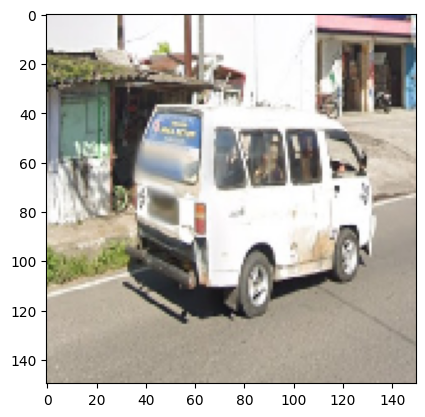

1/1 [==============================] - 0s 143ms/step
mobil


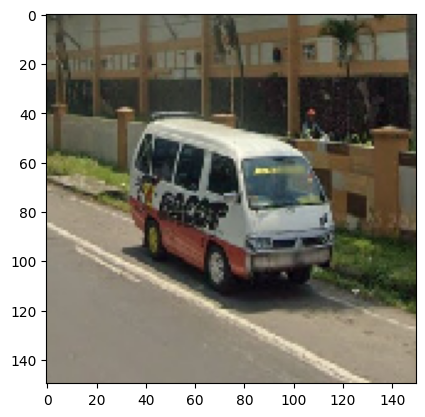

1/1 [==============================] - 0s 52ms/step
bukan mobil


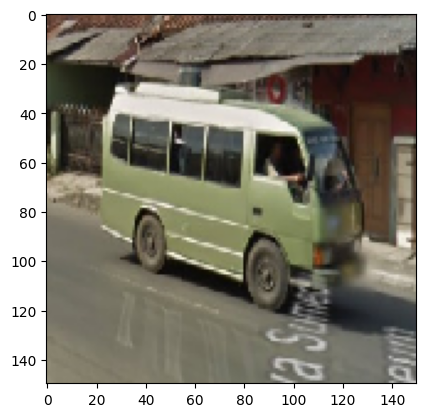

1/1 [==============================] - 0s 49ms/step
bukan mobil


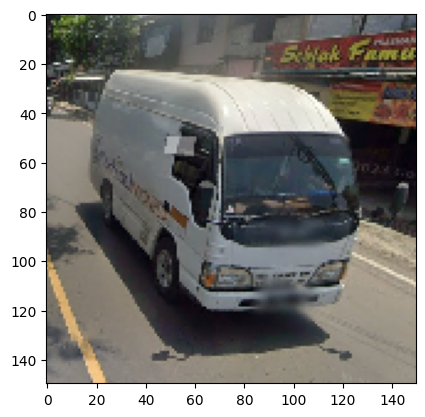

1/1 [==============================] - 0s 58ms/step
mobil


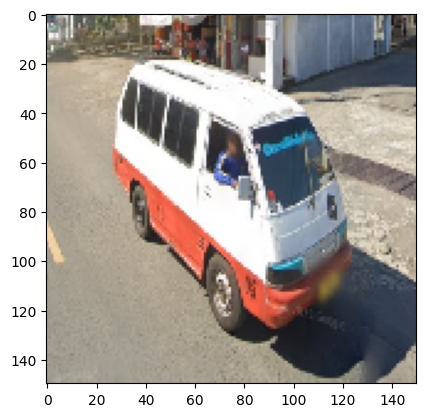

1/1 [==============================] - 0s 68ms/step
mobil


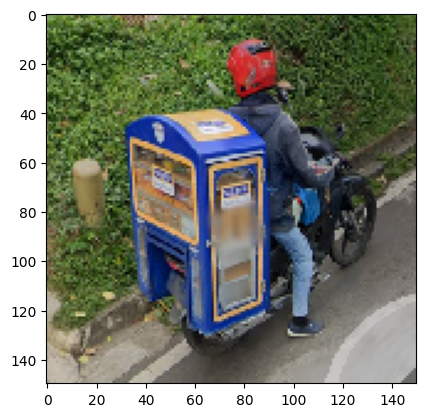

1/1 [==============================] - 0s 50ms/step
bukan mobil


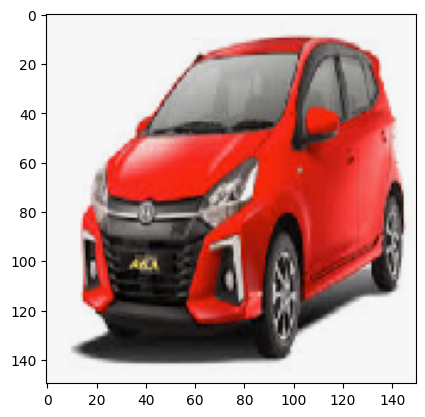

1/1 [==============================] - 0s 52ms/step
bukan mobil


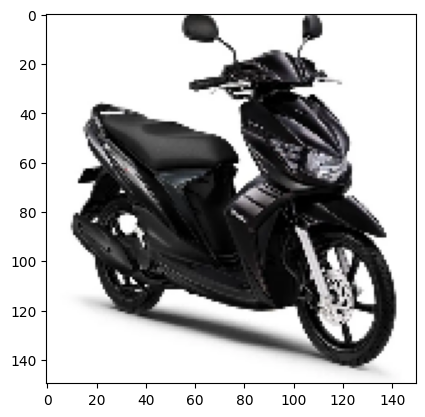

1/1 [==============================] - 0s 47ms/step
mobil


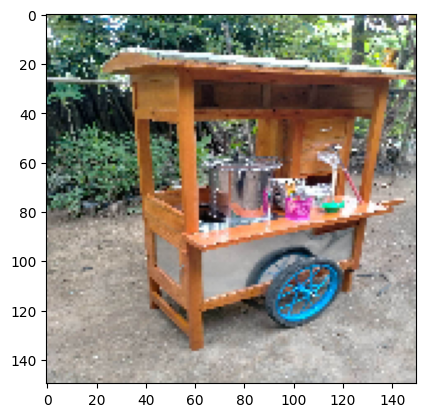

1/1 [==============================] - 0s 42ms/step
bukan mobil


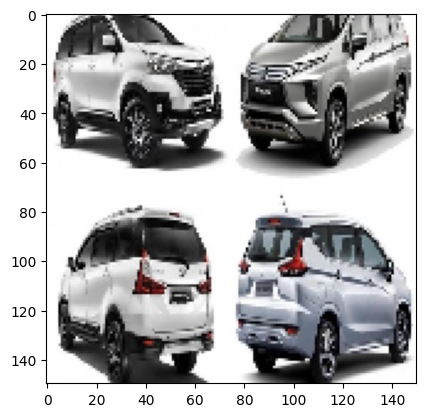

1/1 [==============================] - 0s 54ms/step
mobil


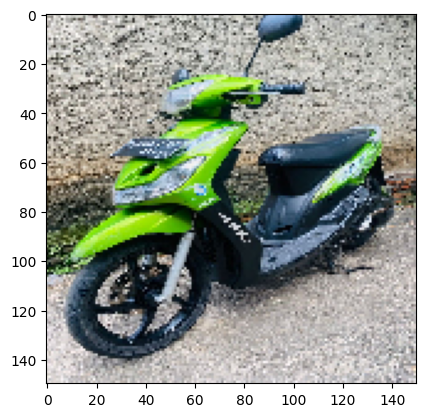

1/1 [==============================] - 0s 42ms/step
bukan mobil


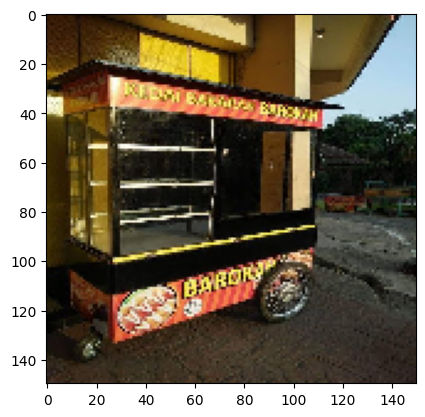

1/1 [==============================] - 0s 43ms/step
bukan mobil


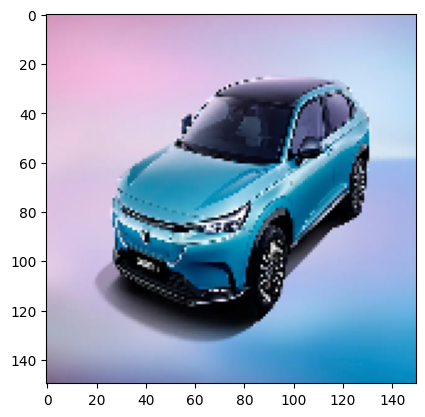

1/1 [==============================] - 0s 41ms/step
mobil


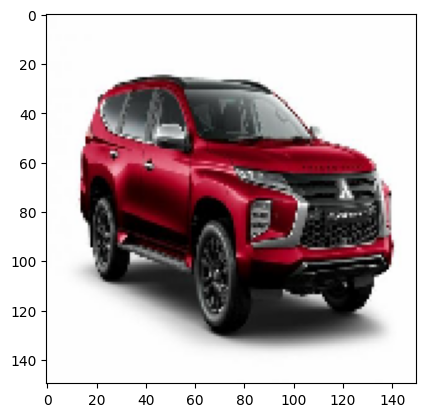

1/1 [==============================] - 0s 34ms/step
bukan mobil


In [19]:
# Inisialisasi objek ImageDataGenerator untuk normalisasi data
test_datagen = ImageDataGenerator(rescale=1./255)

for i in os.listdir(test_dir):
  img = image.load_img(test_dir+'//'+i,target_size=(150,150))
  plt.imshow(img)
  plt.show()

  X = image.img_to_array(img)
  X = np.expand_dims(X,axis=0)
  images = np.vstack([X])
  val = model.predict(images)
  if val == 0:
    print("bukan mobil")
  else:
    print("mobil")

Bisa kita lihat dari hasil testing diatas, masih terdapat kesalahan dalam prediksinya, kali ini kita akan coba mengutak-atik beberapa konvolusi dan poolingnya.

In [20]:
# Bangun model neural network
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(16, (3,3), activation='relu', input_shape=(150, 150, 3)),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(32, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(80, (3,3), activation='relu'), # 64 diubah menjadi 80, dan maxpooling terakhir dihapus
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid')  # 1 karena dua kelas: mobil dan bukan mobil
])

In [21]:
# Kompilasi model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Latih model menggunakan generator
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // 32,
    epochs=5,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // 32
)

Epoch 1/5
6/6 [==============================] - 18s 3s/step - loss: 4.2666 - accuracy: 0.5176 - val_loss: 1.1159 - val_accuracy: 0.5156
Epoch 2/5
6/6 [==============================] - 15s 3s/step - loss: 0.7278 - accuracy: 0.5765 - val_loss: 0.6158 - val_accuracy: 0.7656
Epoch 3/5
6/6 [==============================] - 18s 3s/step - loss: 0.5481 - accuracy: 0.7396 - val_loss: 0.5869 - val_accuracy: 0.7604
Epoch 4/5
6/6 [==============================] - 13s 2s/step - loss: 0.3674 - accuracy: 0.9412 - val_loss: 0.4755 - val_accuracy: 0.7604
Epoch 5/5
6/6 [==============================] - 17s 3s/step - loss: 0.2088 - accuracy: 0.9294 - val_loss: 0.4713 - val_accuracy: 0.7500


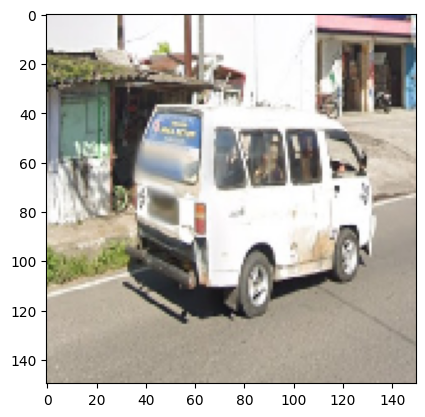

1/1 [==============================] - 0s 150ms/step
mobil


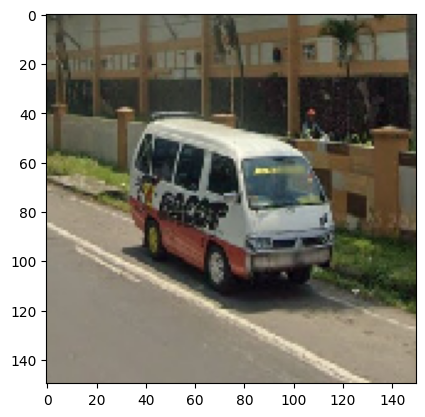

1/1 [==============================] - 0s 61ms/step
mobil


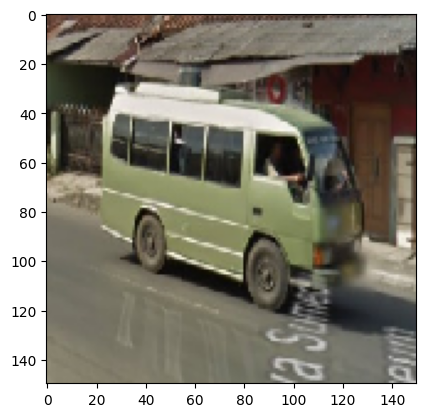

1/1 [==============================] - 0s 68ms/step
mobil


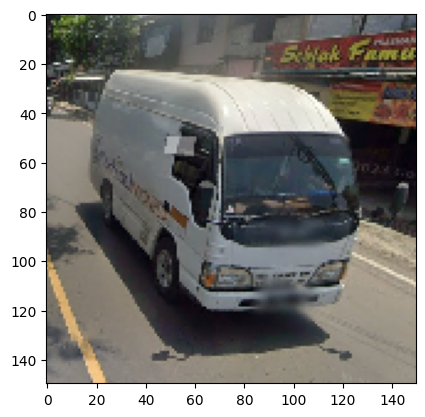

1/1 [==============================] - 0s 69ms/step
mobil


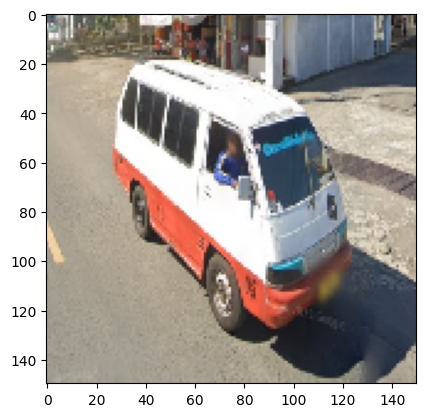

1/1 [==============================] - 0s 50ms/step
mobil


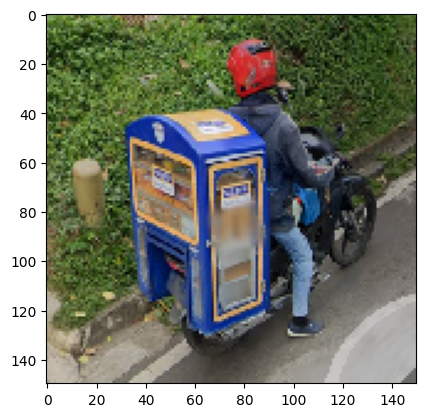

1/1 [==============================] - 0s 56ms/step
bukan mobil


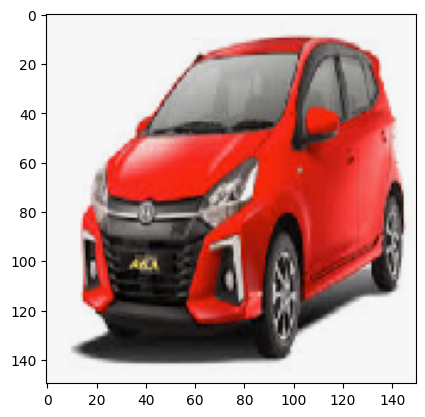

1/1 [==============================] - 0s 46ms/step
bukan mobil


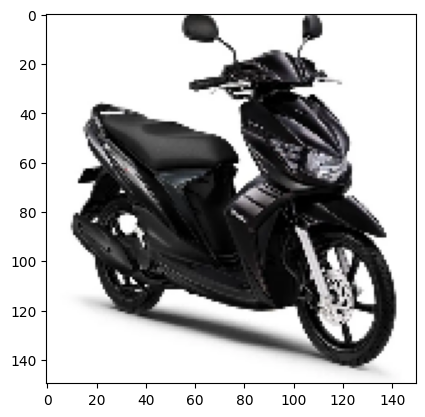

1/1 [==============================] - 0s 46ms/step
bukan mobil


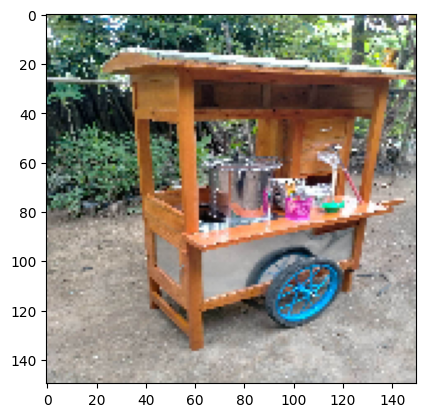

1/1 [==============================] - 0s 58ms/step
bukan mobil


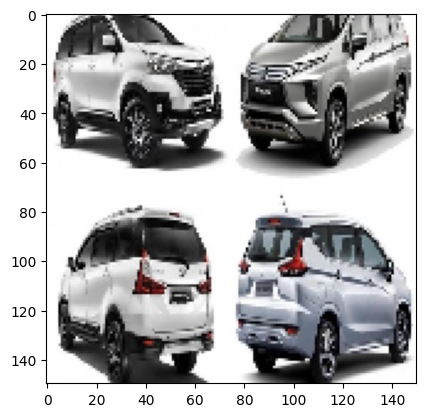

1/1 [==============================] - 0s 54ms/step
mobil


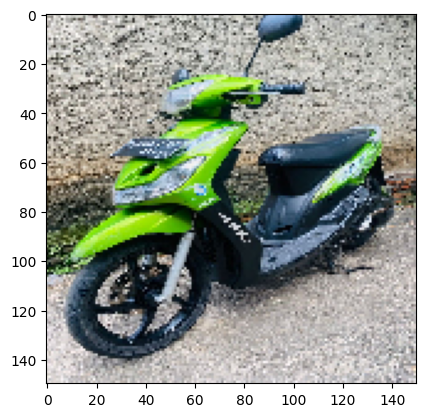

1/1 [==============================] - 0s 72ms/step
bukan mobil


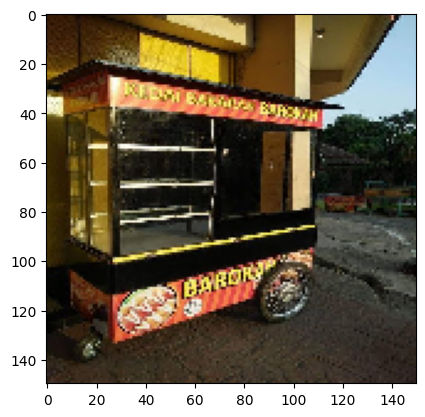

1/1 [==============================] - 0s 78ms/step
bukan mobil


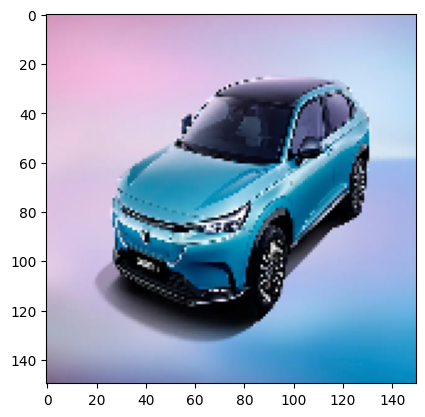

1/1 [==============================] - 0s 56ms/step
mobil


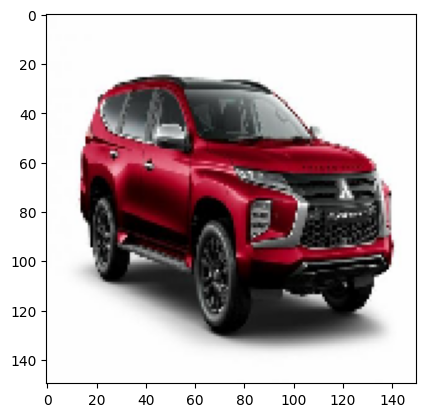

1/1 [==============================] - 0s 54ms/step
mobil


In [22]:
for i in os.listdir(test_dir):
  img = image.load_img(test_dir+'//'+i,target_size=(150,150))
  plt.imshow(img)
  plt.show()

  X = image.img_to_array(img)
  X = np.expand_dims(X,axis=0)
  images = np.vstack([X])
  val = model.predict(images)
  if val == 0:
    print("bukan mobil")
  else:
    print("mobil")

Dapat dilihat hasil kinerja model menunjukan yang awalnya salah prediksi menjadi benar, tapi masih ada sedikit prediksinya yang salah. Berarti kita masih perlu melakukan modifikasi pada model lagi

Kita coba lakukan :
*   Penambahan Lapisan Dropout
*   Penyesuaian Kembali Jumlah Filter pada Convolutional Layers
*   Penambahan Lapisan Normalisasi Batch (Batch Normalization)
*   Penyesuaian Jumlah Epochs

In [23]:
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(150, 150, 3)),
    tf.keras.layers.BatchNormalization(),  # Tambahkan batch normalization
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'), # Exsperimen kembali dengan perubahan filter
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dropout(0.5), # Tambahkan dropout di sini
    tf.keras.layers.Dense(1, activation='sigmoid')
])

Epoch 1/10
6/6 [==============================] - 33s 5s/step - loss: 8.1571 - accuracy: 0.7059 - val_loss: 3.4620 - val_accuracy: 0.5156
Epoch 2/10
6/6 [==============================] - 31s 5s/step - loss: 8.7253 - accuracy: 0.8118 - val_loss: 1.7619 - val_accuracy: 0.5104
Epoch 3/10
6/6 [==============================] - 31s 5s/step - loss: 5.8154 - accuracy: 0.8765 - val_loss: 2.1843 - val_accuracy: 0.4844
Epoch 4/10
6/6 [==============================] - 31s 5s/step - loss: 4.9048 - accuracy: 0.9412 - val_loss: 3.7141 - val_accuracy: 0.5208
Epoch 5/10
6/6 [==============================] - 31s 5s/step - loss: 0.6440 - accuracy: 0.9471 - val_loss: 6.4161 - val_accuracy: 0.4844
Epoch 6/10
6/6 [==============================] - 31s 5s/step - loss: 0.8099 - accuracy: 0.9706 - val_loss: 12.2199 - val_accuracy: 0.4948
Epoch 7/10
6/6 [==============================] - 25s 4s/step - loss: 0.9109 - accuracy: 0.9647 - val_loss: 16.5784 - val_accuracy: 0.4948
Epoch 8/10
6/6 [================

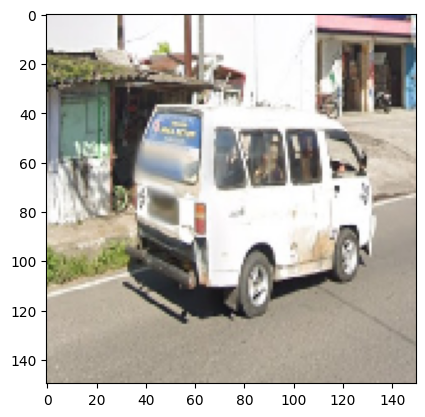

1/1 [==============================] - 0s 357ms/step
bukan mobil


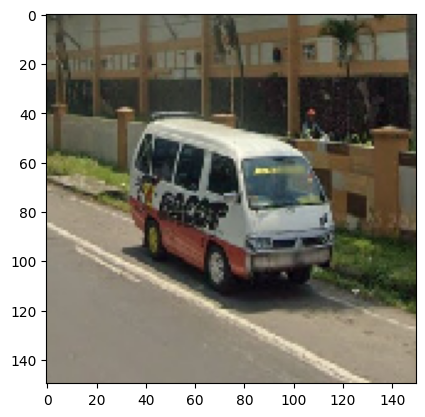

1/1 [==============================] - 0s 285ms/step
bukan mobil


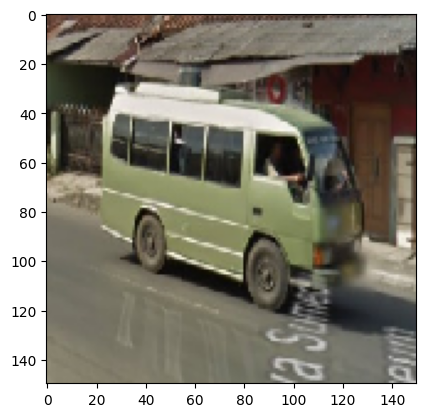

1/1 [==============================] - 0s 206ms/step
bukan mobil


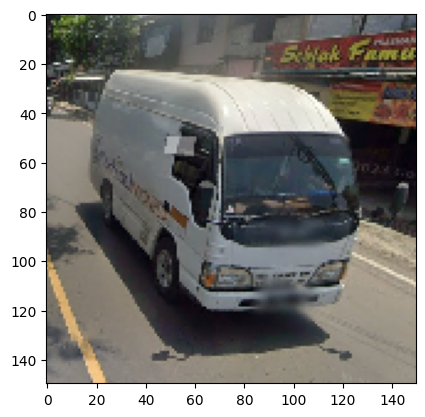

1/1 [==============================] - 0s 99ms/step
bukan mobil


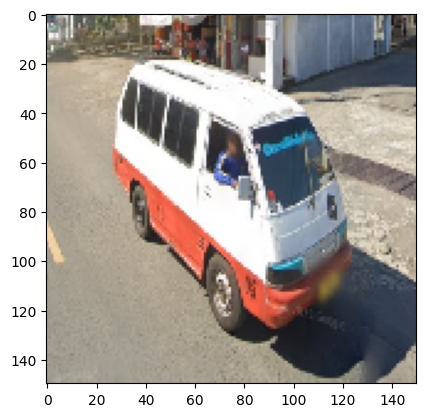

1/1 [==============================] - 0s 118ms/step
mobil


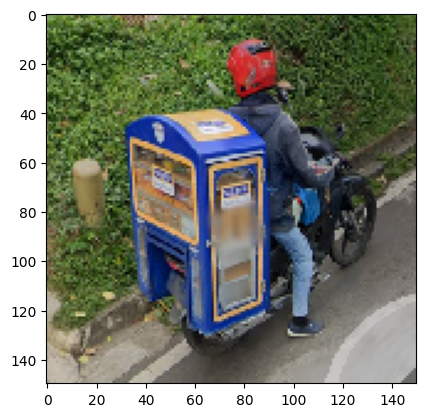

1/1 [==============================] - 0s 125ms/step
bukan mobil


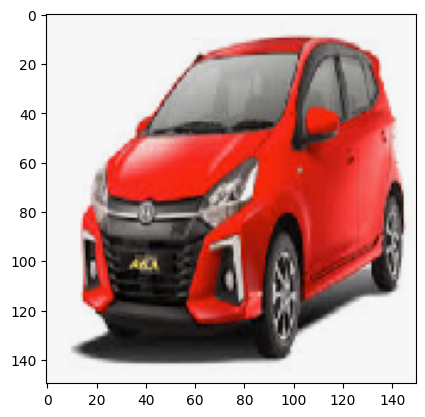

1/1 [==============================] - 0s 70ms/step
bukan mobil


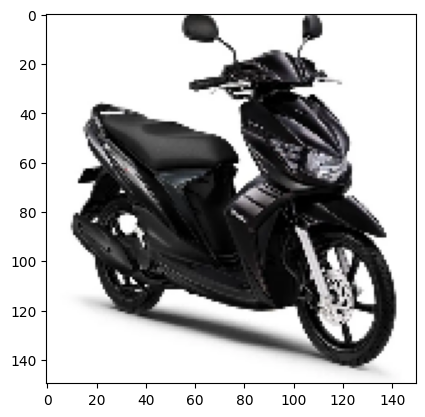

1/1 [==============================] - 0s 193ms/step
bukan mobil


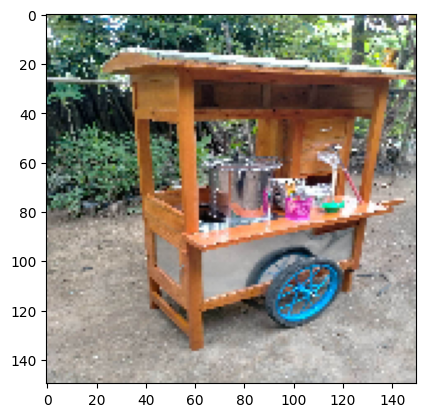

1/1 [==============================] - 0s 123ms/step
bukan mobil


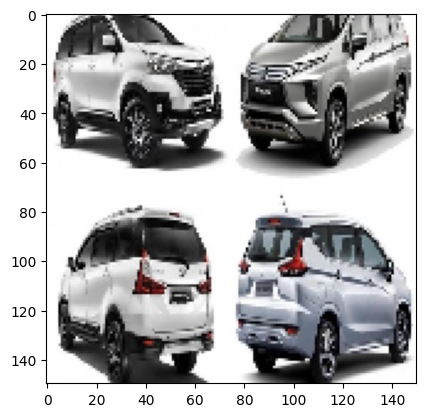

1/1 [==============================] - 0s 91ms/step
bukan mobil


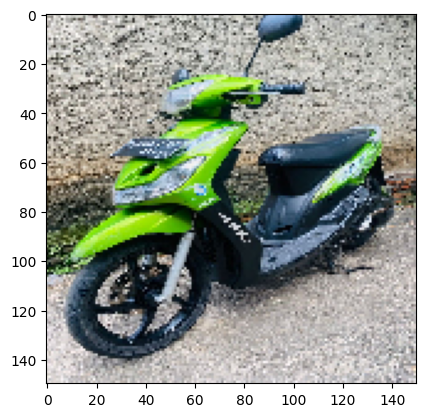

1/1 [==============================] - 0s 84ms/step
bukan mobil


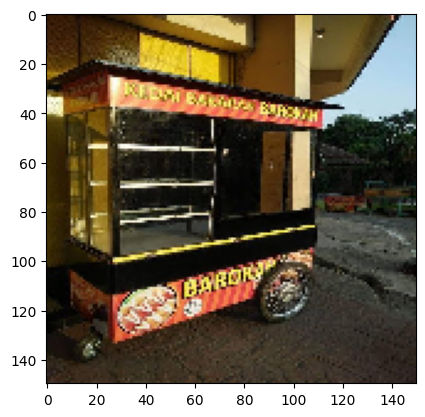

1/1 [==============================] - 0s 79ms/step
mobil


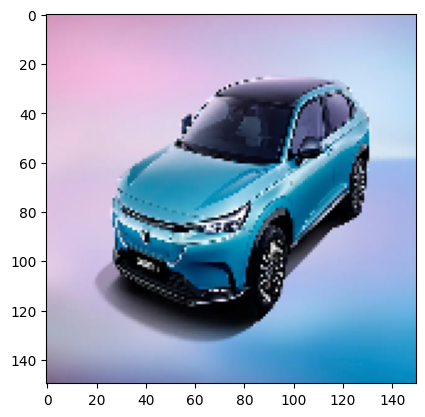

1/1 [==============================] - 0s 86ms/step
bukan mobil


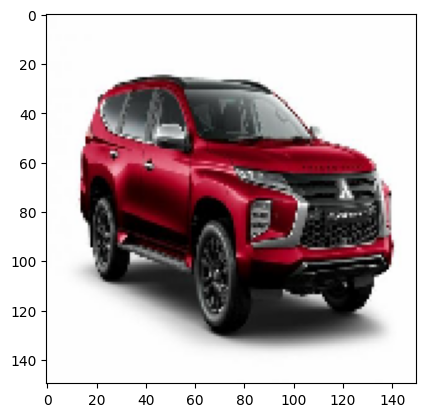

1/1 [==============================] - 0s 75ms/step
bukan mobil


In [24]:
# Kompilasi model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // 32,
    epochs=10,  # Sesuaikan jumlah epochs
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // 32
)

for i in os.listdir(test_dir):
  img = image.load_img(test_dir+'//'+i,target_size=(150,150))
  plt.imshow(img)
  plt.show()

  X = image.img_to_array(img)
  X = np.expand_dims(X,axis=0)
  images = np.vstack([X])
  val = model.predict(images)
  if val == 0:
    print("bukan mobil")
  else:
    print("mobil")


Ternyata hasilnya semakin buruk, banyak gambar yang tidak sesuai klasifikasi. Mari ubah model kembali dengan mencoba menghapus batch normalization nya.

In [25]:
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(150, 150, 3)),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

Epoch 1/10
6/6 [==============================] - 32s 5s/step - loss: 3.2760 - accuracy: 0.5469 - val_loss: 0.7396 - val_accuracy: 0.4896
Epoch 2/10
6/6 [==============================] - 28s 5s/step - loss: 0.6904 - accuracy: 0.5588 - val_loss: 0.6580 - val_accuracy: 0.6875
Epoch 3/10
6/6 [==============================] - 23s 4s/step - loss: 0.6321 - accuracy: 0.6529 - val_loss: 0.5849 - val_accuracy: 0.8177
Epoch 4/10
6/6 [==============================] - 29s 5s/step - loss: 0.5571 - accuracy: 0.7396 - val_loss: 0.4911 - val_accuracy: 0.8281
Epoch 5/10
6/6 [==============================] - 23s 4s/step - loss: 0.4667 - accuracy: 0.8235 - val_loss: 0.6058 - val_accuracy: 0.6719
Epoch 6/10
6/6 [==============================] - 23s 4s/step - loss: 0.3851 - accuracy: 0.9000 - val_loss: 0.4291 - val_accuracy: 0.8594
Epoch 7/10
6/6 [==============================] - 28s 5s/step - loss: 0.3713 - accuracy: 0.8412 - val_loss: 0.4480 - val_accuracy: 0.8125
Epoch 8/10
6/6 [==================

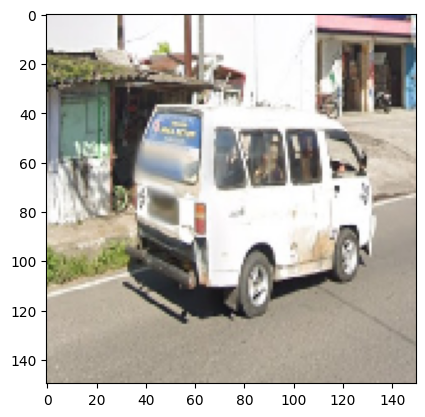

1/1 [==============================] - 0s 155ms/step
mobil


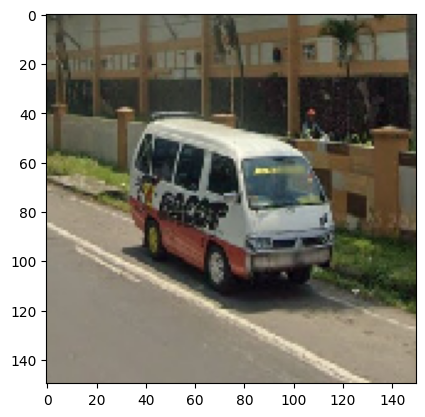

1/1 [==============================] - 0s 62ms/step
bukan mobil


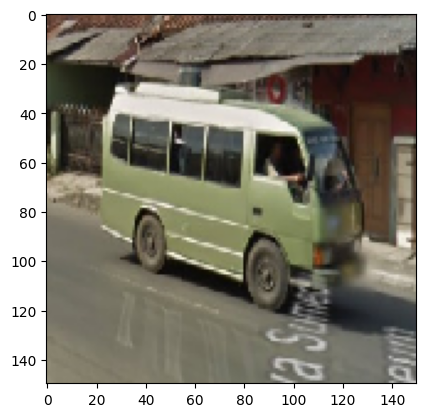

1/1 [==============================] - 0s 71ms/step
mobil


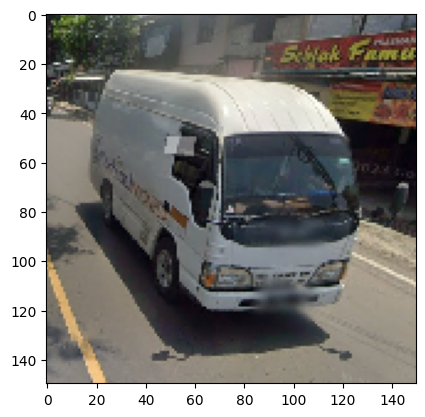

1/1 [==============================] - 0s 84ms/step
bukan mobil


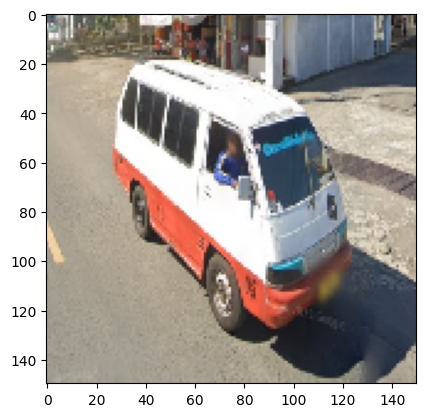

1/1 [==============================] - 0s 101ms/step
mobil


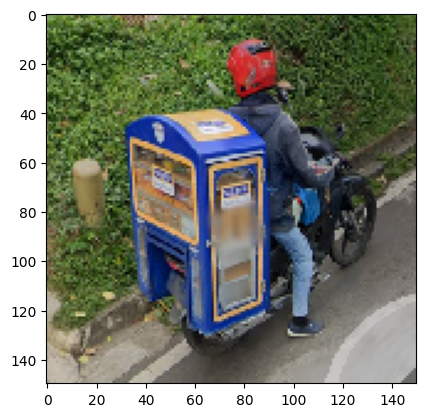

1/1 [==============================] - 0s 112ms/step
bukan mobil


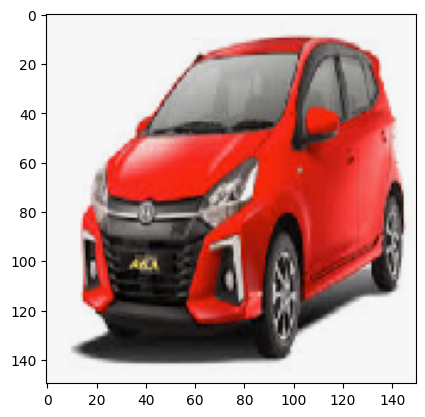

1/1 [==============================] - 0s 89ms/step
bukan mobil


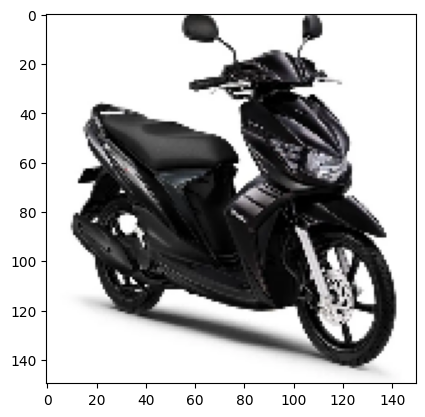

1/1 [==============================] - 0s 87ms/step
bukan mobil


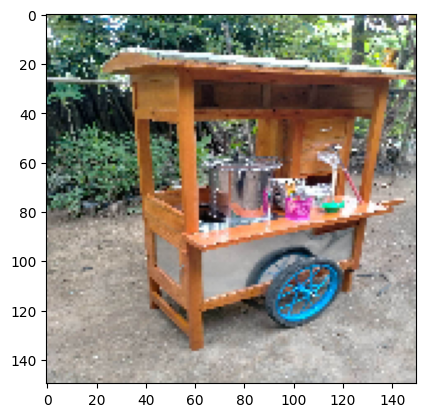

1/1 [==============================] - 0s 125ms/step
bukan mobil


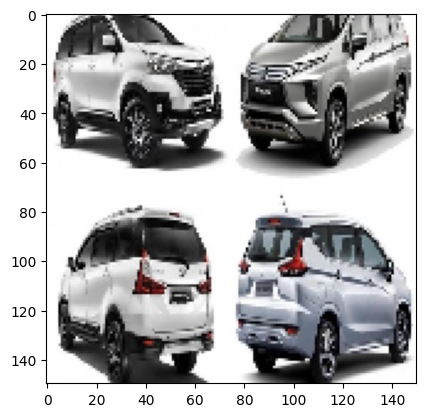

1/1 [==============================] - 0s 126ms/step
bukan mobil


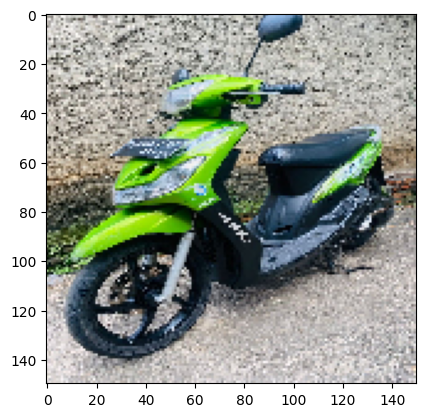

1/1 [==============================] - 0s 96ms/step
bukan mobil


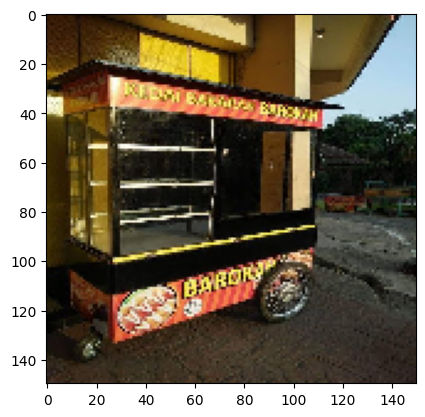

1/1 [==============================] - 0s 130ms/step
bukan mobil


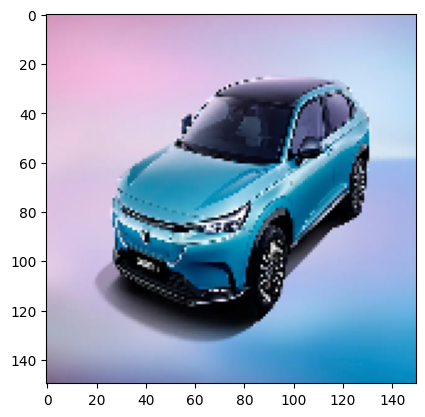

1/1 [==============================] - 0s 86ms/step
bukan mobil


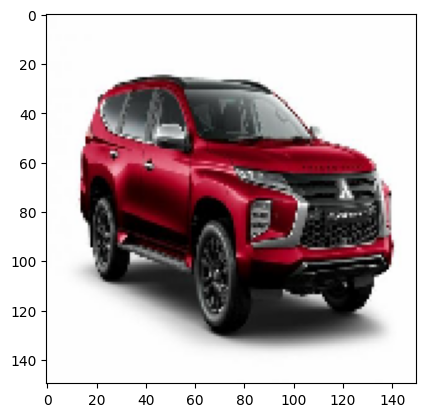

1/1 [==============================] - 0s 89ms/step
mobil


In [26]:
# Kompilasi model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // 32,
    epochs=10,  # Sesuaikan jumlah epochs
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // 32
)

for i in os.listdir(test_dir):
  img = image.load_img(test_dir+'//'+i,target_size=(150,150))
  plt.imshow(img)
  plt.show()

  X = image.img_to_array(img)
  X = np.expand_dims(X,axis=0)
  images = np.vstack([X])
  val = model.predict(images)
  if val == 0:
    print("bukan mobil")
  else:
    print("mobil")


Kinerja model berubah menjadi lebih baik, akan tetapi masih jauh dari kata bagus. Sekarang kita akan coba mengubah convulutional layer nya menjadi 4 channel.

In [28]:
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(4, (3,3), activation='relu', input_shape=(150, 150, 3)),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(32, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(80, (3,3), activation='relu'),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

In [29]:
# Kompilasi model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // 32,
    epochs=10,  # Sesuaikan jumlah epochs
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // 32
)

Epoch 1/10
6/6 [==============================] - 19s 3s/step - loss: 3.3547 - accuracy: 0.4176 - val_loss: 0.9818 - val_accuracy: 0.5156
Epoch 2/10
6/6 [==============================] - 16s 3s/step - loss: 0.7232 - accuracy: 0.6176 - val_loss: 0.6275 - val_accuracy: 0.7292
Epoch 3/10
6/6 [==============================] - 13s 2s/step - loss: 0.5554 - accuracy: 0.7941 - val_loss: 0.6491 - val_accuracy: 0.5469
Epoch 4/10
6/6 [==============================] - 15s 2s/step - loss: 0.4136 - accuracy: 0.8333 - val_loss: 0.5109 - val_accuracy: 0.7396
Epoch 5/10
6/6 [==============================] - 15s 3s/step - loss: 0.2628 - accuracy: 0.9118 - val_loss: 0.4443 - val_accuracy: 0.7917
Epoch 6/10
6/6 [==============================] - 13s 2s/step - loss: 0.2238 - accuracy: 0.9000 - val_loss: 0.5840 - val_accuracy: 0.7292
Epoch 7/10
6/6 [==============================] - 15s 2s/step - loss: 0.1411 - accuracy: 0.9647 - val_loss: 0.5075 - val_accuracy: 0.7708
Epoch 8/10
6/6 [==================

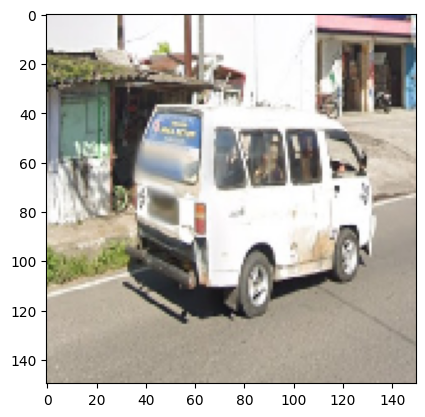

1/1 [==============================] - 0s 211ms/step
mobil


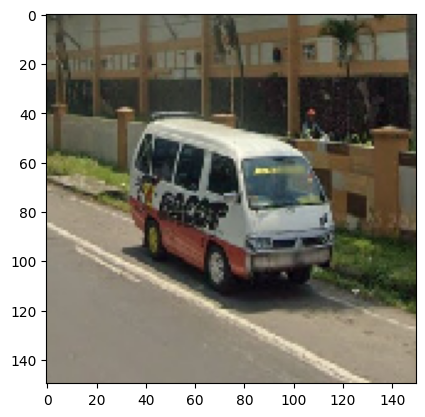

1/1 [==============================] - 0s 72ms/step
bukan mobil


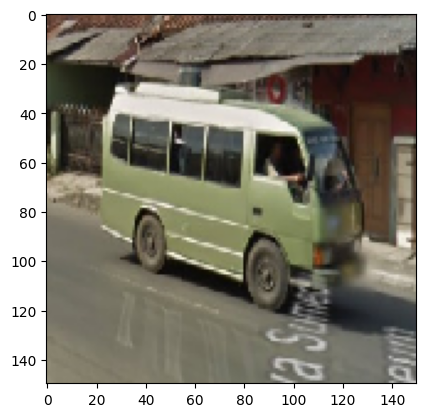

1/1 [==============================] - 0s 55ms/step
mobil


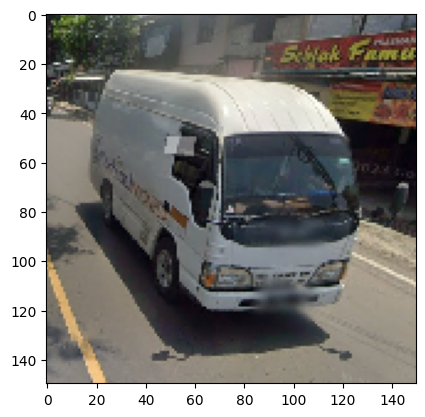

1/1 [==============================] - 0s 46ms/step
mobil


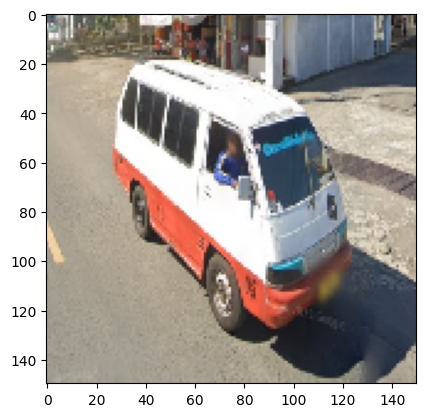

1/1 [==============================] - 0s 47ms/step
mobil


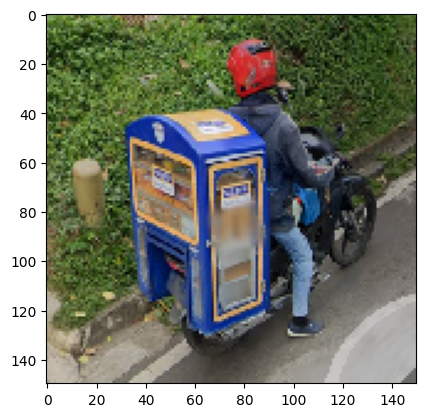

1/1 [==============================] - 0s 54ms/step
bukan mobil


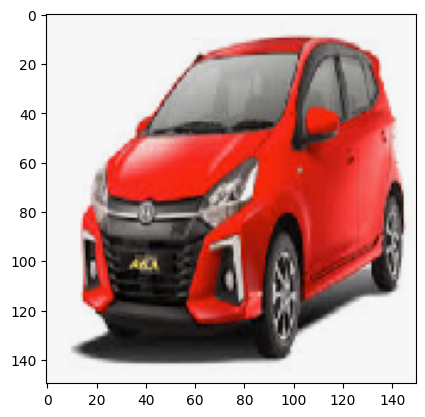

1/1 [==============================] - 0s 69ms/step
mobil


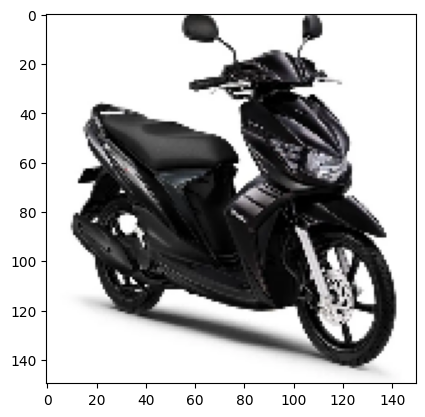

1/1 [==============================] - 0s 71ms/step
bukan mobil


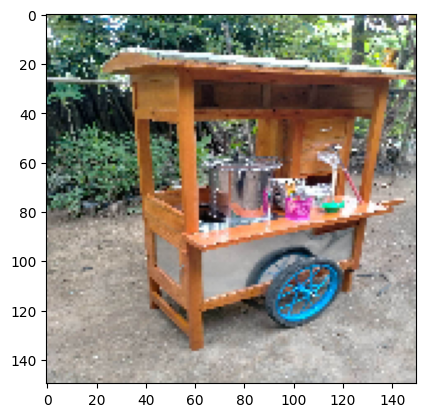

1/1 [==============================] - 0s 89ms/step
bukan mobil


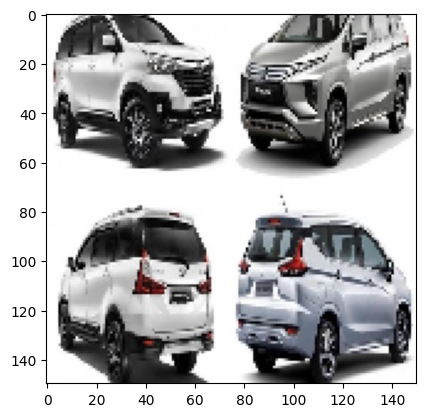

1/1 [==============================] - 0s 80ms/step
mobil


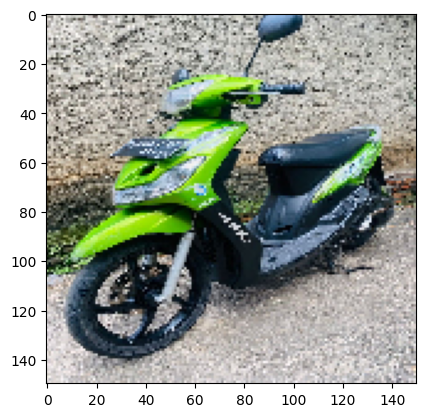

1/1 [==============================] - 0s 65ms/step
mobil


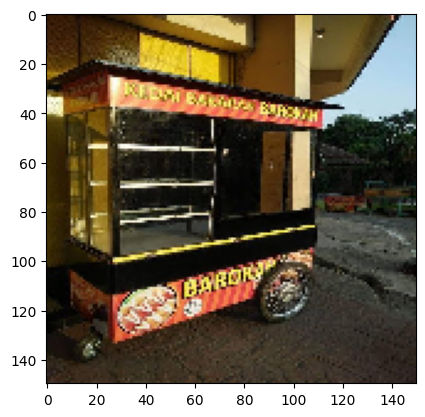

1/1 [==============================] - 0s 102ms/step
bukan mobil


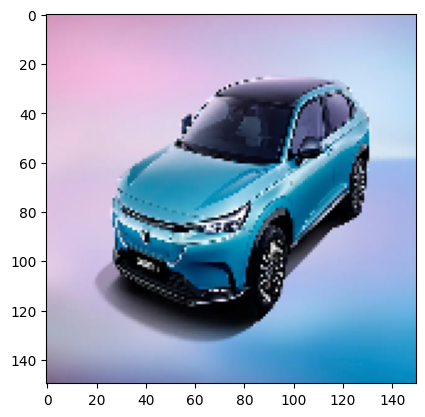

1/1 [==============================] - 0s 78ms/step
mobil


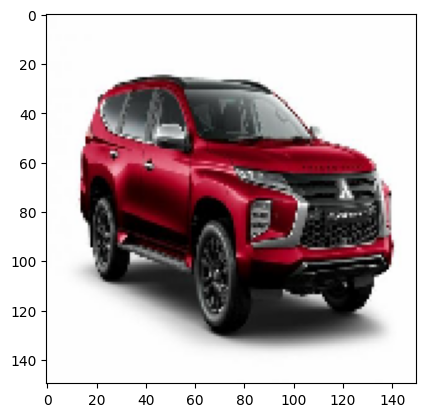

1/1 [==============================] - 0s 67ms/step
mobil


In [30]:
for i in os.listdir(test_dir):
  img = image.load_img(test_dir+'//'+i,target_size=(150,150))
  plt.imshow(img)
  plt.show()

  X = image.img_to_array(img)
  X = np.expand_dims(X,axis=0)
  images = np.vstack([X])
  val = model.predict(images)
  if val == 0:
    print("bukan mobil")
  else:
    print("mobil")

Sekarang kinerja model sudah menjadi lebih baik, tapi masih ada sedikitt kesalahan prediksi. Terakhir bagaimana jika menggunakan model sekarang tapi mengurangi jumlah epoch nya menjadi seperti pada model di awal.

In [31]:
# Kompilasi model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // 32,
    epochs=5,  # Sesuaikan jumlah epochs
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // 32
)

Epoch 1/5
6/6 [==============================] - 23s 4s/step - loss: 0.4012 - accuracy: 0.9062 - val_loss: 1.1693 - val_accuracy: 0.6875
Epoch 2/5
6/6 [==============================] - 17s 3s/step - loss: 0.1480 - accuracy: 0.9706 - val_loss: 0.5350 - val_accuracy: 0.6979
Epoch 3/5
6/6 [==============================] - 16s 3s/step - loss: 0.1767 - accuracy: 0.9529 - val_loss: 0.4504 - val_accuracy: 0.7656
Epoch 4/5
6/6 [==============================] - 13s 2s/step - loss: 0.1229 - accuracy: 0.9882 - val_loss: 0.4597 - val_accuracy: 0.7604
Epoch 5/5
6/6 [==============================] - 15s 3s/step - loss: 0.0519 - accuracy: 0.9941 - val_loss: 0.6988 - val_accuracy: 0.7760


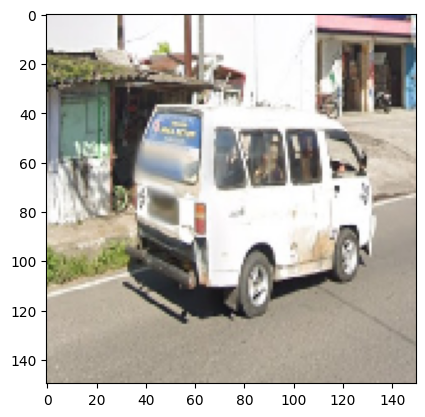

1/1 [==============================] - 0s 223ms/step
mobil


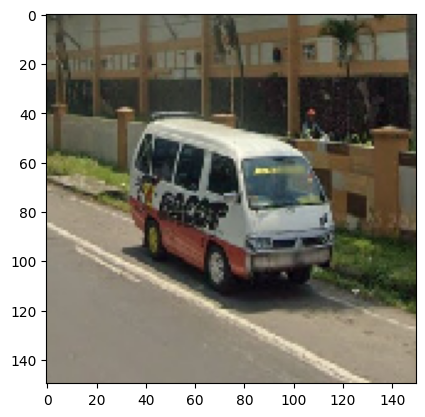

1/1 [==============================] - 0s 90ms/step
bukan mobil


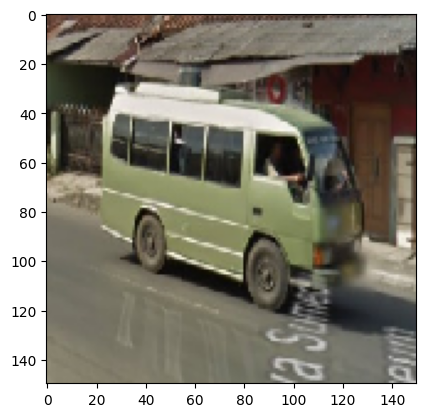

1/1 [==============================] - 0s 128ms/step
mobil


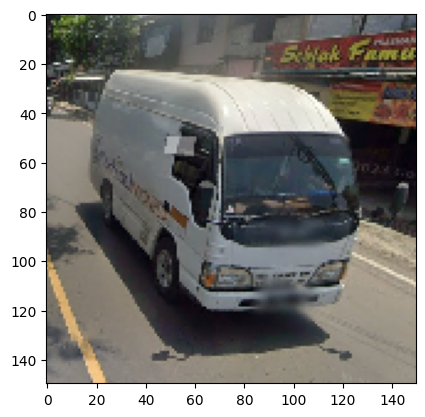

1/1 [==============================] - 0s 194ms/step
mobil


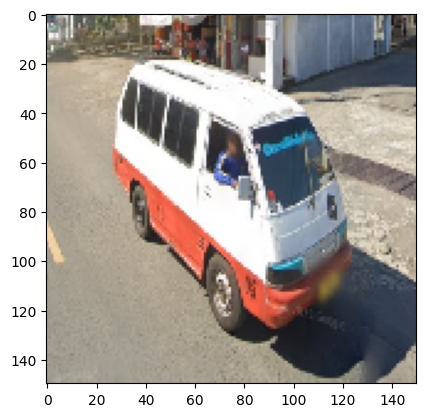

1/1 [==============================] - 0s 52ms/step
mobil


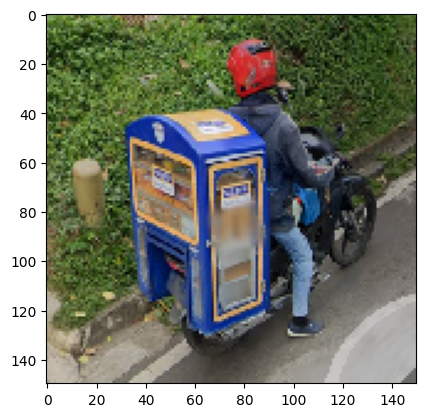

1/1 [==============================] - 0s 54ms/step
bukan mobil


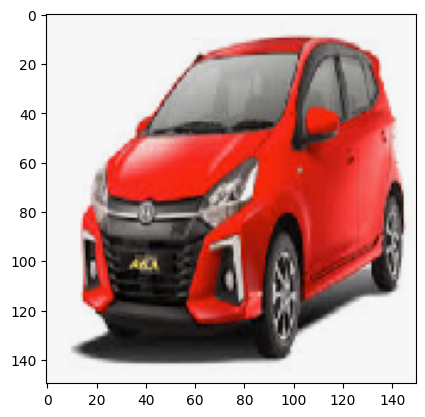

1/1 [==============================] - 0s 45ms/step
bukan mobil


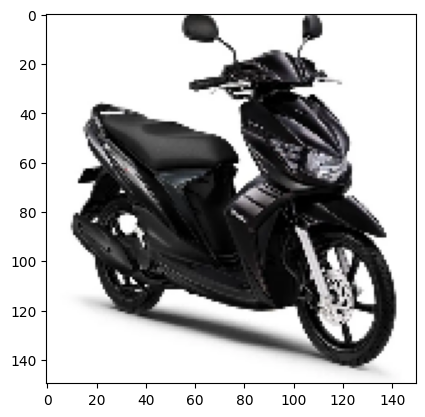

1/1 [==============================] - 0s 49ms/step
bukan mobil


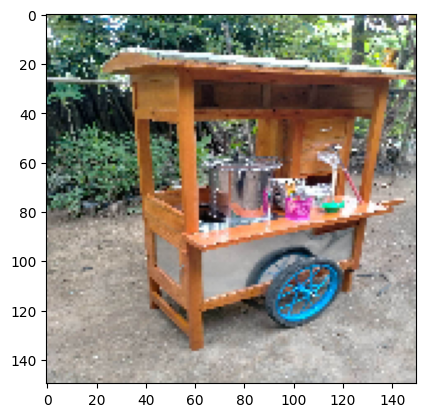

1/1 [==============================] - 0s 57ms/step
bukan mobil


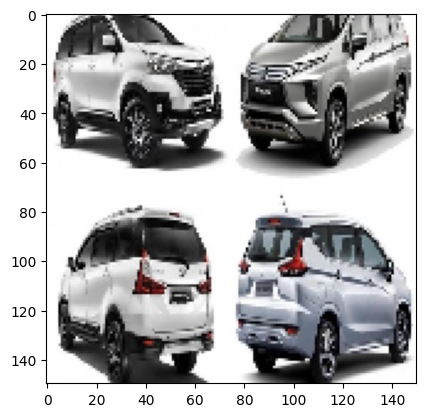

1/1 [==============================] - 0s 57ms/step
bukan mobil


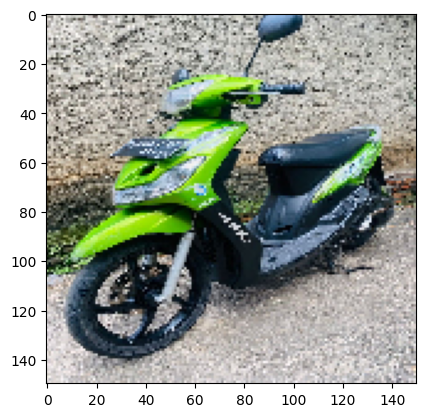

1/1 [==============================] - 0s 62ms/step
bukan mobil


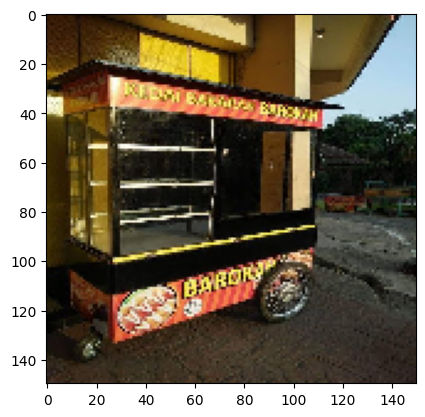

1/1 [==============================] - 0s 88ms/step
bukan mobil


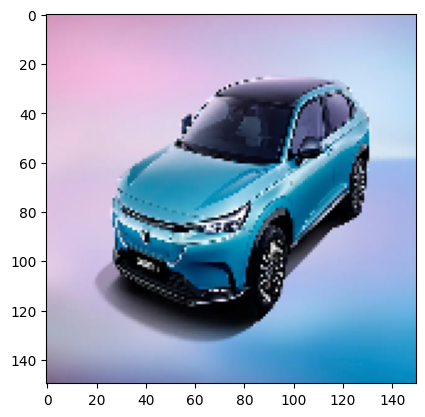

1/1 [==============================] - 0s 53ms/step
mobil


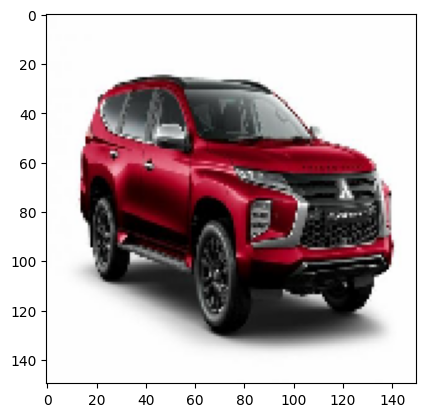

1/1 [==============================] - 0s 52ms/step
bukan mobil


In [32]:
for i in os.listdir(test_dir):
  img = image.load_img(test_dir+'//'+i,target_size=(150,150))
  plt.imshow(img)
  plt.show()

  X = image.img_to_array(img)
  X = np.expand_dims(X,axis=0)
  images = np.vstack([X])
  val = model.predict(images)
  if val == 0:
    print("bukan mobil")
  else:
    print("mobil")

Hasil kinerja modelnya tidak terlalu berubah secara signifikan, mari coba gunakan kembali model dengan 10 epoch

In [33]:
# Kompilasi model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // 32,
    epochs=10,  # Sesuaikan jumlah epochs
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // 32
)

Epoch 1/10
6/6 [==============================] - 18s 3s/step - loss: 0.0780 - accuracy: 0.9635 - val_loss: 0.9618 - val_accuracy: 0.6927
Epoch 2/10
6/6 [==============================] - 15s 3s/step - loss: 0.0385 - accuracy: 0.9882 - val_loss: 0.6589 - val_accuracy: 0.7604
Epoch 3/10
6/6 [==============================] - 19s 3s/step - loss: 0.0229 - accuracy: 0.9941 - val_loss: 0.8799 - val_accuracy: 0.7760
Epoch 4/10
6/6 [==============================] - 16s 3s/step - loss: 0.0235 - accuracy: 0.9948 - val_loss: 0.9375 - val_accuracy: 0.7656
Epoch 5/10
6/6 [==============================] - 19s 3s/step - loss: 0.0085 - accuracy: 0.9941 - val_loss: 0.8155 - val_accuracy: 0.7656
Epoch 6/10
6/6 [==============================] - 16s 3s/step - loss: 0.0048 - accuracy: 1.0000 - val_loss: 0.8114 - val_accuracy: 0.7812
Epoch 7/10
6/6 [==============================] - 17s 3s/step - loss: 0.0046 - accuracy: 1.0000 - val_loss: 0.8259 - val_accuracy: 0.7865
Epoch 8/10
6/6 [==================

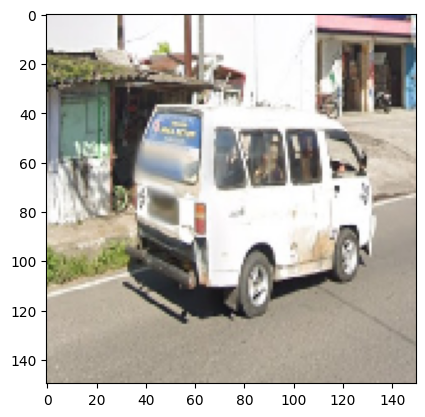

1/1 [==============================] - 0s 385ms/step
mobil


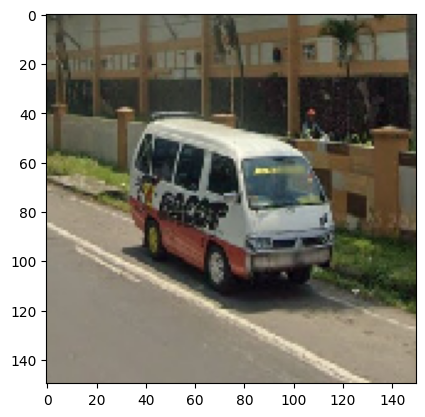

1/1 [==============================] - 0s 150ms/step
bukan mobil


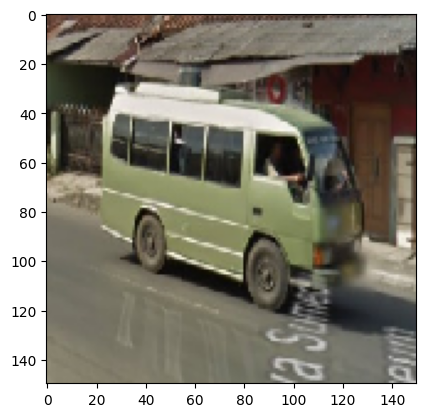

1/1 [==============================] - 0s 69ms/step
mobil


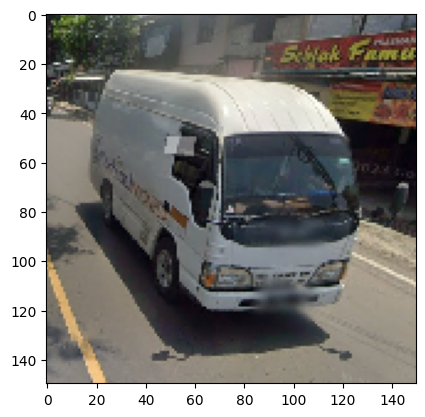

1/1 [==============================] - 0s 46ms/step
mobil


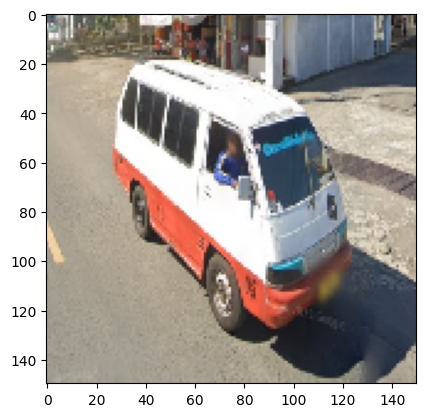

1/1 [==============================] - 0s 47ms/step
mobil


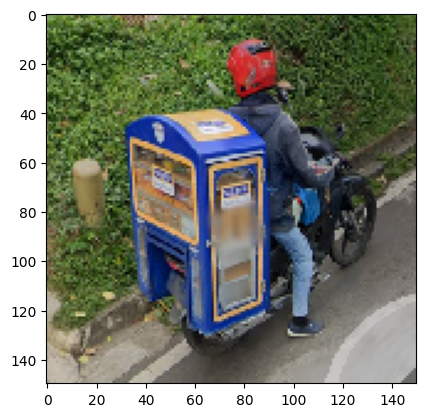

1/1 [==============================] - 0s 55ms/step
bukan mobil


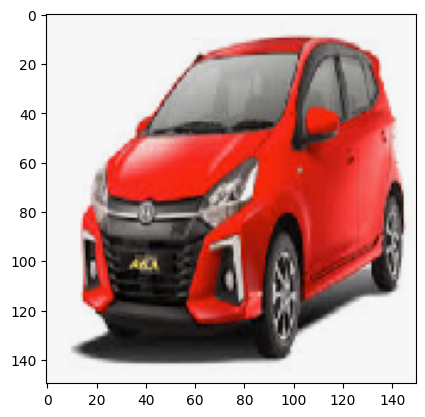

1/1 [==============================] - 0s 49ms/step
mobil


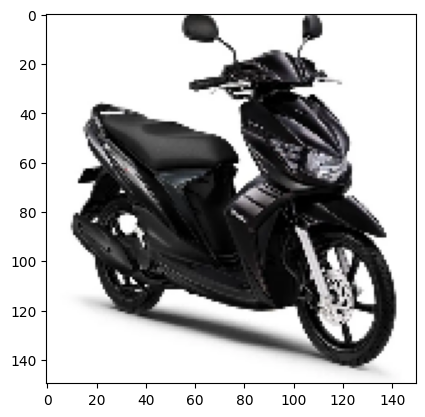

1/1 [==============================] - 0s 51ms/step
bukan mobil


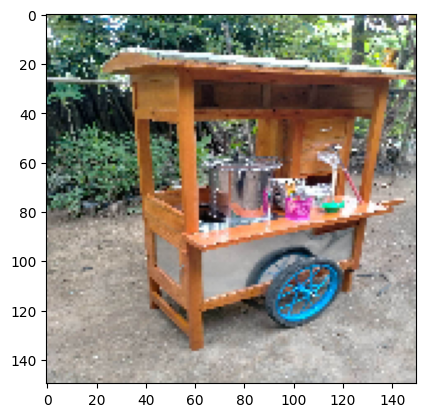

1/1 [==============================] - 0s 76ms/step
bukan mobil


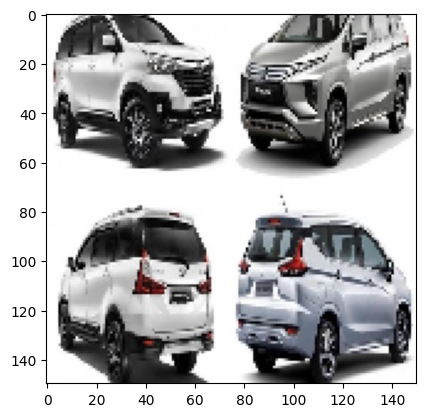

1/1 [==============================] - 0s 52ms/step
bukan mobil


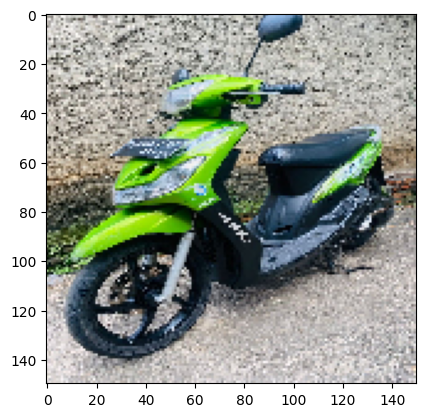

1/1 [==============================] - 0s 64ms/step
mobil


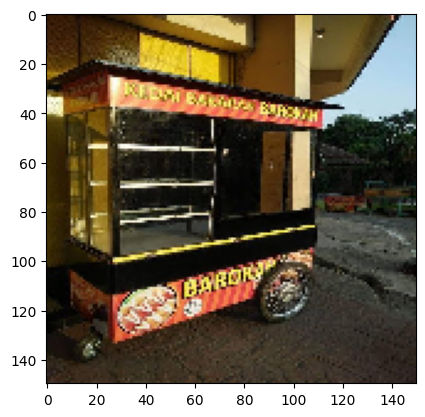

1/1 [==============================] - 0s 82ms/step
bukan mobil


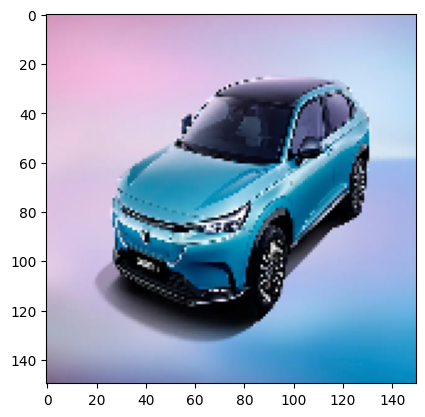

1/1 [==============================] - 0s 56ms/step
mobil


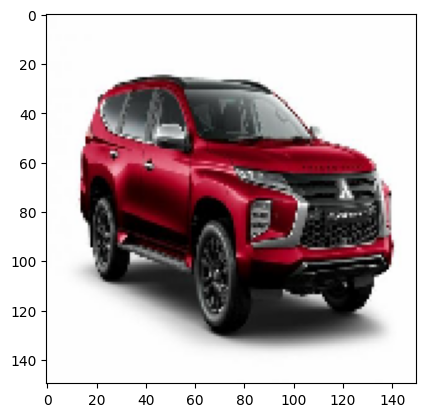

1/1 [==============================] - 0s 52ms/step
bukan mobil


In [34]:
for i in os.listdir(test_dir):
  img = image.load_img(test_dir+'//'+i,target_size=(150,150))
  plt.imshow(img)
  plt.show()

  X = image.img_to_array(img)
  X = np.expand_dims(X,axis=0)
  images = np.vstack([X])
  val = model.predict(images)
  if val == 0:
    print("bukan mobil")
  else:
    print("mobil")

Sekarang kita gunakan kembali model dengan layer sebelum 4 channel, tapi dengan jumlah epoch 5

In [35]:
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(150, 150, 3)),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

In [36]:
# Kompilasi model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // 32,
    epochs=5,  # Sesuaikan jumlah epochs
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // 32
)

Epoch 1/5
6/6 [==============================] - 27s 4s/step - loss: 2.4544 - accuracy: 0.4588 - val_loss: 0.6960 - val_accuracy: 0.5156
Epoch 2/5
6/6 [==============================] - 29s 5s/step - loss: 0.6571 - accuracy: 0.5941 - val_loss: 0.6507 - val_accuracy: 0.5990
Epoch 3/5
6/6 [==============================] - 23s 4s/step - loss: 0.5930 - accuracy: 0.6941 - val_loss: 0.5749 - val_accuracy: 0.6979
Epoch 4/5
6/6 [==============================] - 31s 6s/step - loss: 0.4598 - accuracy: 0.8542 - val_loss: 0.4788 - val_accuracy: 0.7760
Epoch 5/5
6/6 [==============================] - 23s 4s/step - loss: 0.3546 - accuracy: 0.8706 - val_loss: 0.5349 - val_accuracy: 0.7448


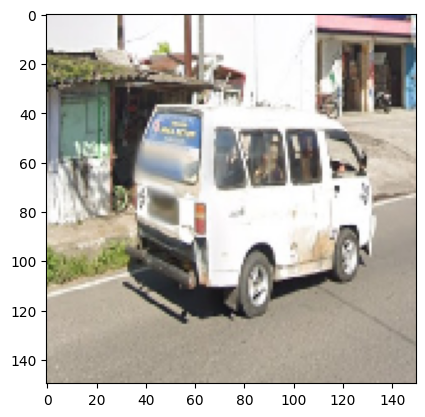

1/1 [==============================] - 0s 228ms/step
mobil


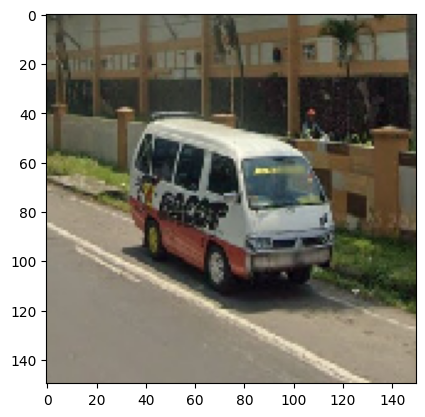

1/1 [==============================] - 0s 97ms/step
bukan mobil


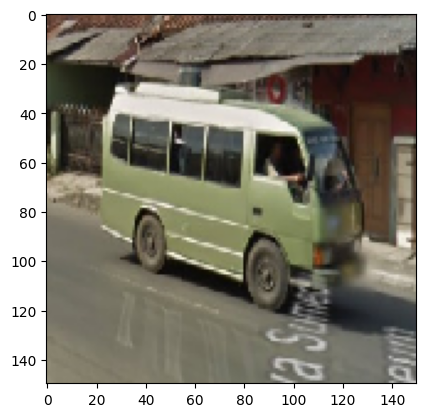

1/1 [==============================] - 0s 63ms/step
mobil


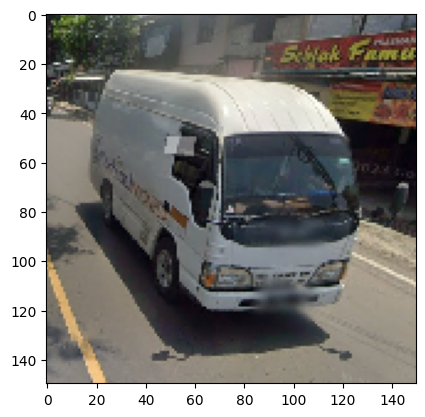

1/1 [==============================] - 0s 61ms/step
mobil


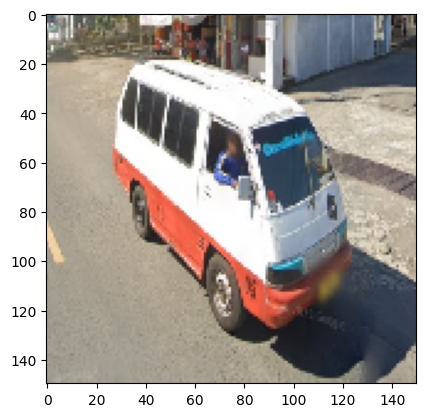

1/1 [==============================] - 0s 73ms/step
mobil


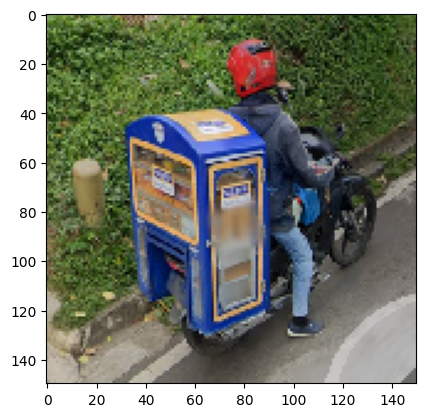

1/1 [==============================] - 0s 69ms/step
bukan mobil


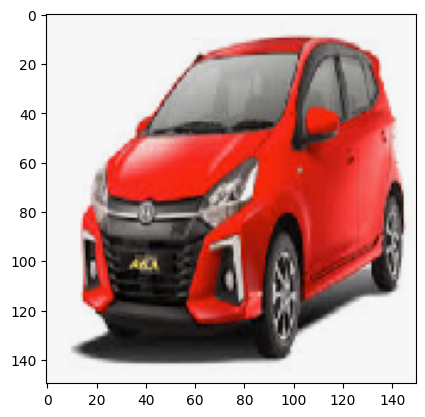

1/1 [==============================] - 0s 64ms/step
mobil


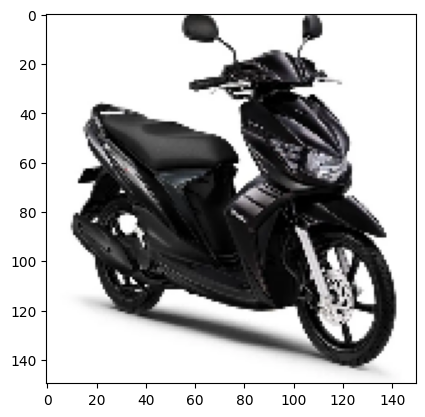

1/1 [==============================] - 0s 61ms/step
mobil


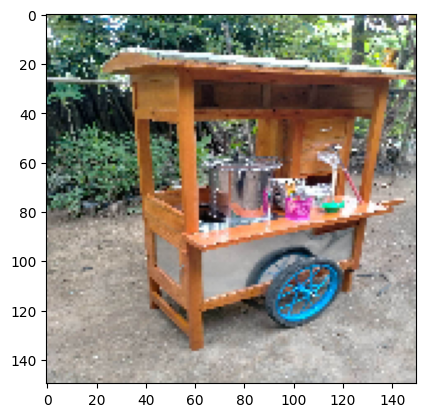

1/1 [==============================] - 0s 81ms/step
bukan mobil


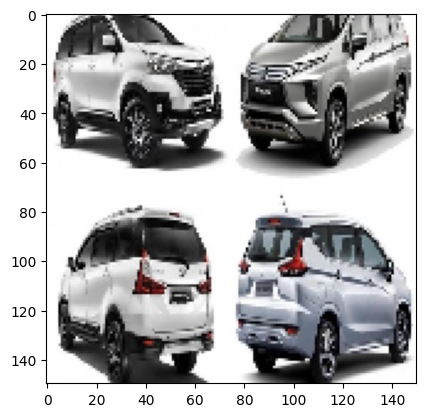

1/1 [==============================] - 0s 71ms/step
mobil


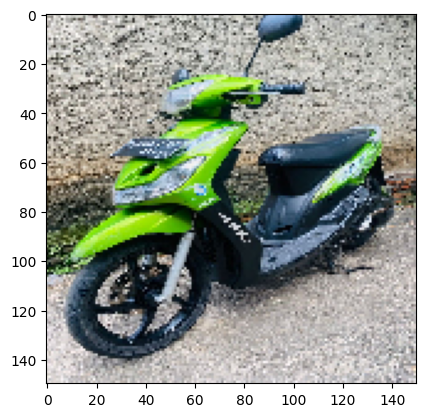

1/1 [==============================] - 0s 89ms/step
mobil


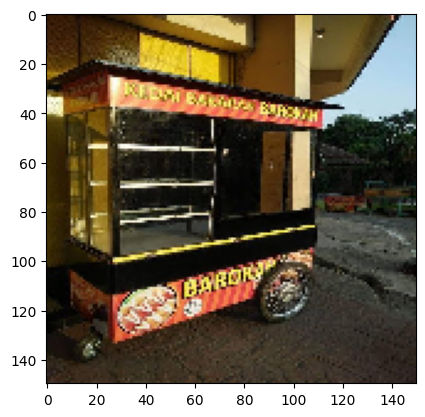

1/1 [==============================] - 0s 71ms/step
bukan mobil


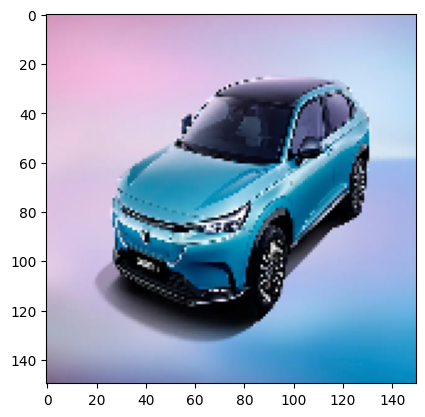

1/1 [==============================] - 0s 83ms/step
mobil


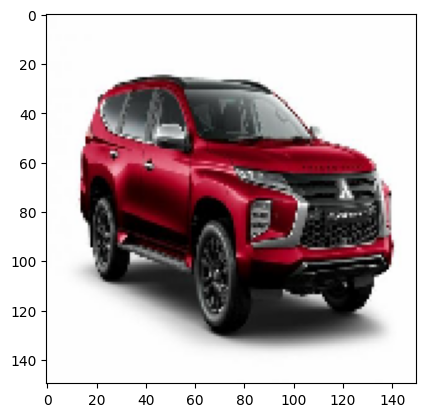

1/1 [==============================] - 0s 70ms/step
mobil


In [37]:
for i in os.listdir(test_dir):
  img = image.load_img(test_dir+'//'+i,target_size=(150,150))
  plt.imshow(img)
  plt.show()

  X = image.img_to_array(img)
  X = np.expand_dims(X,axis=0)
  images = np.vstack([X])
  val = model.predict(images)
  if val == 0:
    print("bukan mobil")
  else:
    print("mobil")

Kinerja dapat dibilang membaik, tapi masih belum sangat baik. Sejauh ini kinerja model terbaik ada pada kedua dari awal dan yang sekarang.